 # Telecom Churn CaseStudy

### The objective of this case study is to predict potential telecom churners - i.e. customers who are projected to quit their telecom service provider in the next month for a different service provider - and find out what are the significant variables to predict the churn. 
#### Churn is said to be the biggest problem in the telecom industry as it is much more expensive to bring in new customers than to retain the existing ones. No wonder, wireless carriers take the opportunities to stop potential churns by addressing customers’ concerns or offering them some lucrative deals very seriously.
#### In this problem, we would be comparing multiple classification algorithms to find out what is the best way to predict churn. Our goal would be to focus on Recall with some compromise over Precision or Accuracy. This is because high recall means that most customers who actually churned are being predicted as churners - i.e. False Negatives are minimum. At the same time, we don’t want precision to be too low, which would mean a high number of False Positives are being predicted, which in turn would mean precious resources would be wasted in trying to retain customers who are actually not going to churn.   

## Steps

1. Data Cleaning
2. Data Preparation
3. Data Visualization
4. Model Building for prediction: Logistics Regression , Random Forest(with HPT) and XGBoost (with HPT) with PCA and SMOTE
5. Model Comparison 
6. Model building for selecting best features as churn indicators: Random Forest with and without SMOTE

In [209]:
# importing important libraries

import pandas as pd, numpy as np
import matplotlib.pyplot as plt, seaborn as sns
import datetime


# supress warnings
import warnings
warnings.filterwarnings("ignore")

from sklearn.preprocessing import StandardScaler
from sklearn.model_selection import train_test_split,GridSearchCV, RandomizedSearchCV, cross_val_score
from sklearn.decomposition import PCA
from sklearn.linear_model import LogisticRegression
from sklearn import metrics
from sklearn.ensemble import RandomForestClassifier


import plotly.graph_objs as go

import xgboost as xgb 

In [210]:
# set display max rows to None
pd.options.display.max_rows = None 

# set display max columns to 50
pd.set_option('display.max_columns', 50)
#pd.options.display.max_columns = None

#sns style
sns.set_style("whitegrid")

In [211]:
# loading dataset
telecom = pd.read_csv('telecom_churn_data.csv')
telecom.head()

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,last_date_of_month_9,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,onnet_mou_9,offnet_mou_6,offnet_mou_7,offnet_mou_8,offnet_mou_9,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_ic_mou_9,...,monthly_2g_6,monthly_2g_7,monthly_2g_8,monthly_2g_9,sachet_2g_6,sachet_2g_7,sachet_2g_8,sachet_2g_9,monthly_3g_6,monthly_3g_7,monthly_3g_8,monthly_3g_9,sachet_3g_6,sachet_3g_7,sachet_3g_8,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g
0,7000842753,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,197.385,214.816,213.803,21.100,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,NaN,NaN,0.00,NaN,...,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,1.0,1.0,1.0,NaN,968,30.4,0.0,101.20,3.58
1,7001865778,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,34.047,355.074,268.321,86.285,24.11,78.68,7.68,18.34,15.74,99.84,304.76,53.76,0.0,0.00,0.00,0.00,...,0,1,0,0,0,0,2,0,0,0,0,0,0,0,0,0,NaN,1.0,1.0,NaN,1006,0.0,0.0,0.00,0.00
2,7001625959,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,167.690,189.058,210.226,290.714,11.54,55.24,37.26,74.81,143.33,220.59,208.36,118.91,0.0,0.00,0.00,38.49,...,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,NaN,NaN,NaN,1.0,1103,0.0,0.0,4.17,0.00
3,7001204172,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,221.338,251.102,508.054,389.500,99.91,54.39,310.98,241.71,123.31,109.01,71.68,113.54,0.0,54.86,44.38,0.00,...,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,NaN,NaN,NaN,NaN,2491,0.0,0.0,0.00,0.00
4,7000142493,109,0.0,0.0,0.0,6/30/2014,7/31/2014,8/31/2014,9/30/2014,261.636,309.876,238.174,163.426,50.31,149.44,83.89,58.78,76.96,91.88,124.26,45.81,0.0,0.00,0.00,0.00,...,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,0.0,NaN,NaN,NaN,1526,0.0,0.0,0.00,0.00


In [212]:
# checking shape
telecom.shape

(99999, 226)

In [213]:
# info
telecom.info()

<class 'pandas.core.frame.DataFrame'>
RangeIndex: 99999 entries, 0 to 99998
Columns: 226 entries, mobile_number to sep_vbc_3g
dtypes: float64(179), int64(35), object(12)
memory usage: 172.4+ MB


In [214]:
telecom.describe(include='all')

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,last_date_of_month_9,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,onnet_mou_9,offnet_mou_6,offnet_mou_7,offnet_mou_8,offnet_mou_9,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_ic_mou_9,...,monthly_2g_6,monthly_2g_7,monthly_2g_8,monthly_2g_9,sachet_2g_6,sachet_2g_7,sachet_2g_8,sachet_2g_9,monthly_3g_6,monthly_3g_7,monthly_3g_8,monthly_3g_9,sachet_3g_6,sachet_3g_7,sachet_3g_8,sachet_3g_9,fb_user_6,fb_user_7,fb_user_8,fb_user_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g
count,9.999900e+04,99999.0,98981.0,98981.0,98981.0,99999,99398,98899,98340,99999.000000,99999.000000,99999.000000,99999.000000,96062.000000,96140.000000,94621.000000,92254.000000,96062.000000,96140.000000,94621.000000,92254.000000,96062.000000,96140.000000,94621.000000,92254.000000,...,99999.000000,99999.000000,99999.000000,99999.000000,99999.000000,99999.000000,99999.000000,99999.000000,99999.000000,99999.000000,99999.000000,99999.000000,99999.000000,99999.000000,99999.000000,99999.000000,25153.000000,25571.000000,26339.000000,25922.000000,99999.000000,99999.000000,99999.000000,99999.000000,99999.000000
unique,NaN,NaN,NaN,NaN,NaN,1,1,1,1,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
top,NaN,NaN,NaN,NaN,NaN,6/30/2014,7/31/2014,8/31/2014,9/30/2014,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
freq,NaN,NaN,NaN,NaN,NaN,99999,99398,98899,98340,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,...,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN,NaN
mean,7.001207e+09,109.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,282.987358,278.536648,279.154731,261.645069,132.395875,133.670805,133.018098,130.302327,197.935577,197.045133,196.574803,190.337222,9.950013,7.149898,7.292981,6.343841,...,0.079641,0.083221,0.081001,0.068781,0.389384,0.439634,0.450075,0.393104,0.075921,0.078581,0.082941,0.086341,0.074781,0.080401,0.084501,0.084581,0.914404,0.908764,0.890808,0.860968,1219.854749,68.170248,66.839062,60.021204,3.299373
std,6.956694e+05,0.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,328.439770,338.156291,344.474791,341.998630,297.207406,308.794148,308.951589,308.477668,316.851613,325.862803,327.170662,319.396092,72.825411,73.447948,68.402466,57.137537,...,0.295058,0.304395,0.299568,0.278120,1.497320,1.636230,1.630263,1.347140,0.363371,0.387231,0.384947,0.384978,0.568344,0.628334,0.660234,0.650457,0.279772,0.287950,0.311885,0.345987,954.733842,267.580450,271.201856,253.938223,32.408353
min,7.000000e+09,109.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,-2258.709000,-2014.045000,-945.808000,-1899.505000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,180.000000,0.000000,0.000000,0.000000,0.000000
25%,7.000606e+09,109.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,93.411500,86.980500,84.126000,62.685000,7.380000,6.660000,6.460000,5.330000,34.730000,32.190000,31.630000,27.130000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1.000000,1.000000,1.000000,1.000000,467.000000,0.000000,0.000000,0.000000,0.000000
50%,7.001205e+09,109.0,0.0,0.0,0.0,NaN,NaN,NaN,NaN,197.704000,191.640000,192.080000,176.849000,34.310000,32.330000,32.360000,29.840000,96.310000,91.735000,92.140000,87.290000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.0

In [215]:
# checking object data types
telecom.columns[telecom.dtypes== object]

Index(['last_date_of_month_6', 'last_date_of_month_7', 'last_date_of_month_8',
       'last_date_of_month_9', 'date_of_last_rech_6', 'date_of_last_rech_7',
       'date_of_last_rech_8', 'date_of_last_rech_9',
       'date_of_last_rech_data_6', 'date_of_last_rech_data_7',
       'date_of_last_rech_data_8', 'date_of_last_rech_data_9'],
      dtype='object')

date columns are object type columns in dataset.

## 1. Data Cleaning

In [216]:
# checking null percentage in each column
null_percentage = telecom.isnull().sum()*100/ len(telecom.index)
null_percentage[null_percentage != 0]

loc_og_t2o_mou               1.018010
std_og_t2o_mou               1.018010
loc_ic_t2o_mou               1.018010
last_date_of_month_7         0.601006
last_date_of_month_8         1.100011
last_date_of_month_9         1.659017
onnet_mou_6                  3.937039
onnet_mou_7                  3.859039
onnet_mou_8                  5.378054
onnet_mou_9                  7.745077
offnet_mou_6                 3.937039
offnet_mou_7                 3.859039
offnet_mou_8                 5.378054
offnet_mou_9                 7.745077
roam_ic_mou_6                3.937039
roam_ic_mou_7                3.859039
roam_ic_mou_8                5.378054
roam_ic_mou_9                7.745077
roam_og_mou_6                3.937039
roam_og_mou_7                3.859039
roam_og_mou_8                5.378054
roam_og_mou_9                7.745077
loc_og_t2t_mou_6             3.937039
loc_og_t2t_mou_7             3.859039
loc_og_t2t_mou_8             5.378054
loc_og_t2t_mou_9             7.745077
loc_og_t2m_m

In [217]:
# average reachage amount null implies that recharge was not done so imputing with zero
col_list =list(('av_rech_amt_data_6','av_rech_amt_data_7', 'av_rech_amt_data_8', 'av_rech_amt_data_9'))
for col in col_list:
    telecom[col].fillna(value=0, inplace= True)

In [218]:
# total reharge data null also implies that data recharge was not done so imputing with zero
col_list =list(('total_rech_data_6','total_rech_data_7', 'total_rech_data_8', 'total_rech_data_9'))
for col in col_list:
    telecom[col].fillna(value=0, inplace= True)

In [219]:
# dropping date columns
#telecom = telecom.select_dtypes(exclude=['object'])
for column in telecom.columns[telecom.dtypes== object]:
    telecom[column] = pd.to_datetime(telecom[column])


In [220]:
telecom.dtypes

mobile_number                        int64
circle_id                            int64
loc_og_t2o_mou                     float64
std_og_t2o_mou                     float64
loc_ic_t2o_mou                     float64
last_date_of_month_6        datetime64[ns]
last_date_of_month_7        datetime64[ns]
last_date_of_month_8        datetime64[ns]
last_date_of_month_9        datetime64[ns]
arpu_6                             float64
arpu_7                             float64
arpu_8                             float64
arpu_9                             float64
onnet_mou_6                        float64
onnet_mou_7                        float64
onnet_mou_8                        float64
onnet_mou_9                        float64
offnet_mou_6                       float64
offnet_mou_7                       float64
offnet_mou_8                       float64
offnet_mou_9                       float64
roam_ic_mou_6                      float64
roam_ic_mou_7                      float64
roam_ic_mou

In [221]:
# checking null percentage greater than 70
null_percentage = telecom.isnull().sum()*100/ len(telecom.index)
null_percentage[null_percentage > 70]

date_of_last_rech_data_6    74.846748
date_of_last_rech_data_7    74.428744
date_of_last_rech_data_8    73.660737
date_of_last_rech_data_9    74.077741
max_rech_data_6             74.846748
max_rech_data_7             74.428744
max_rech_data_8             73.660737
max_rech_data_9             74.077741
count_rech_2g_6             74.846748
count_rech_2g_7             74.428744
count_rech_2g_8             73.660737
count_rech_2g_9             74.077741
count_rech_3g_6             74.846748
count_rech_3g_7             74.428744
count_rech_3g_8             73.660737
count_rech_3g_9             74.077741
arpu_3g_6                   74.846748
arpu_3g_7                   74.428744
arpu_3g_8                   73.660737
arpu_3g_9                   74.077741
arpu_2g_6                   74.846748
arpu_2g_7                   74.428744
arpu_2g_8                   73.660737
arpu_2g_9                   74.077741
night_pck_user_6            74.846748
night_pck_user_7            74.428744
night_pck_us

In [222]:
# fb_user and night_pack_user are categorical columns 
# max_recharge, count_recharge, arpu are numerical columns

# dropping columns more than 70% missing values
telecom.drop(list(null_percentage[null_percentage > 70].keys()), axis =1, inplace =True)

In [223]:
telecom.dtypes

mobile_number                    int64
circle_id                        int64
loc_og_t2o_mou                 float64
std_og_t2o_mou                 float64
loc_ic_t2o_mou                 float64
last_date_of_month_6    datetime64[ns]
last_date_of_month_7    datetime64[ns]
last_date_of_month_8    datetime64[ns]
last_date_of_month_9    datetime64[ns]
arpu_6                         float64
arpu_7                         float64
arpu_8                         float64
arpu_9                         float64
onnet_mou_6                    float64
onnet_mou_7                    float64
onnet_mou_8                    float64
onnet_mou_9                    float64
offnet_mou_6                   float64
offnet_mou_7                   float64
offnet_mou_8                   float64
offnet_mou_9                   float64
roam_ic_mou_6                  float64
roam_ic_mou_7                  float64
roam_ic_mou_8                  float64
roam_ic_mou_9                  float64
roam_og_mou_6            

In [224]:
# imputing for other values where null implies zero
telecom.fillna(value=0, inplace= True)

In [225]:
telecom.head()

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,last_date_of_month_9,arpu_6,arpu_7,arpu_8,arpu_9,onnet_mou_6,onnet_mou_7,onnet_mou_8,onnet_mou_9,offnet_mou_6,offnet_mou_7,offnet_mou_8,offnet_mou_9,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_ic_mou_9,...,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,vol_3g_mb_9,monthly_2g_6,monthly_2g_7,monthly_2g_8,monthly_2g_9,sachet_2g_6,sachet_2g_7,sachet_2g_8,sachet_2g_9,monthly_3g_6,monthly_3g_7,monthly_3g_8,monthly_3g_9,sachet_3g_6,sachet_3g_7,sachet_3g_8,sachet_3g_9,aon,aug_vbc_3g,jul_vbc_3g,jun_vbc_3g,sep_vbc_3g
0,7000842753,109,0.0,0.0,0.0,2014-06-30,2014-07-31 00:00:00,2014-08-31 00:00:00,2014-09-30 00:00:00,197.385,214.816,213.803,21.100,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.00,0.00,...,83.57,150.76,109.61,0.00,0,0,0,0,0,0,0,0,1,1,1,0,0,0,0,0,968,30.4,0.0,101.20,3.58
1,7001865778,109,0.0,0.0,0.0,2014-06-30,2014-07-31 00:00:00,2014-08-31 00:00:00,2014-09-30 00:00:00,34.047,355.074,268.321,86.285,24.11,78.68,7.68,18.34,15.74,99.84,304.76,53.76,0.0,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0,1,0,0,0,0,2,0,0,0,0,0,0,0,0,0,1006,0.0,0.0,0.00,0.00
2,7001625959,109,0.0,0.0,0.0,2014-06-30,2014-07-31 00:00:00,2014-08-31 00:00:00,2014-09-30 00:00:00,167.690,189.058,210.226,290.714,11.54,55.24,37.26,74.81,143.33,220.59,208.36,118.91,0.0,0.00,0.00,38.49,...,0.00,0.00,0.00,8.42,0,0,0,0,0,0,0,1,0,0,0,0,0,0,0,0,1103,0.0,0.0,4.17,0.00
3,7001204172,109,0.0,0.0,0.0,2014-06-30,2014-07-31 00:00:00,2014-08-31 00:00:00,2014-09-30 00:00:00,221.338,251.102,508.054,389.500,99.91,54.39,310.98,241.71,123.31,109.01,71.68,113.54,0.0,54.86,44.38,0.00,...,0.00,0.00,0.00,0.00,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,0,2491,0.0,0.0,0.00,0.00
4,7000142493,109,0.0,0.0,0.0,2014-06-30,2014-07-31 00:00:00,2014-08-31 00:00:00,2014-09-30 00:00:00,261.636,309.876,238.174,163.426,50.31,149.44,83.89,58.78,76.96,91.88,124.26,45.81,0.0,0.00,0.00,0.00,...,0.00,0.00,0.00,0.00,0,0,0,0,1,0,0,0,0,0,0,0,0,0,0,0,1526,0.0,0.0,0.00,0.00


In [226]:
# imputing missing dates with the value 1/1/1900
date_columns = telecom.columns[telecom.dtypes== object]
for column in date_columns:
    telecom[column] = telecom[column].replace(0,'1/1/1900')
for column in date_columns:
    telecom[column] = pd.to_datetime(telecom[column])

In [227]:
telecom.dtypes

mobile_number                    int64
circle_id                        int64
loc_og_t2o_mou                 float64
std_og_t2o_mou                 float64
loc_ic_t2o_mou                 float64
last_date_of_month_6    datetime64[ns]
last_date_of_month_7    datetime64[ns]
last_date_of_month_8    datetime64[ns]
last_date_of_month_9    datetime64[ns]
arpu_6                         float64
arpu_7                         float64
arpu_8                         float64
arpu_9                         float64
onnet_mou_6                    float64
onnet_mou_7                    float64
onnet_mou_8                    float64
onnet_mou_9                    float64
offnet_mou_6                   float64
offnet_mou_7                   float64
offnet_mou_8                   float64
offnet_mou_9                   float64
roam_ic_mou_6                  float64
roam_ic_mou_7                  float64
roam_ic_mou_8                  float64
roam_ic_mou_9                  float64
roam_og_mou_6            

In [228]:
# checking null percentage
null_percentage = telecom.isnull().sum()*100/ len(telecom.index)
null_percentage[null_percentage != 0]

Series([], dtype: float64)

### Selecting High Value customers

In [229]:
# getting total recharge amount for data by multiplying average rechage amount and total recharges
telecom['total_data_recharge_6'] = telecom.av_rech_amt_data_6 * telecom.total_rech_data_6
telecom['total_data_recharge_7'] = telecom.av_rech_amt_data_7 * telecom.total_rech_data_7
telecom['total_data_recharge_8'] = telecom.av_rech_amt_data_8 * telecom.total_rech_data_8

In [230]:
# total recharge amount 
telecom['6th_and_7th_total_amt'] = telecom.total_data_recharge_6 + telecom.total_data_recharge_7 + telecom.total_rech_amt_6 + telecom.total_rech_amt_7

In [231]:
# filtering high value customers
telecom_hcv = telecom[telecom['6th_and_7th_total_amt'] > telecom['6th_and_7th_total_amt'].quantile(.7)]

In [232]:
telecom_hcv.shape

(29953, 198)

In [233]:
telecom_hcv.dtypes

mobile_number                     int64
circle_id                         int64
loc_og_t2o_mou                  float64
std_og_t2o_mou                  float64
loc_ic_t2o_mou                  float64
last_date_of_month_6     datetime64[ns]
last_date_of_month_7     datetime64[ns]
last_date_of_month_8     datetime64[ns]
last_date_of_month_9     datetime64[ns]
arpu_6                          float64
arpu_7                          float64
arpu_8                          float64
arpu_9                          float64
onnet_mou_6                     float64
onnet_mou_7                     float64
onnet_mou_8                     float64
onnet_mou_9                     float64
offnet_mou_6                    float64
offnet_mou_7                    float64
offnet_mou_8                    float64
offnet_mou_9                    float64
roam_ic_mou_6                   float64
roam_ic_mou_7                   float64
roam_ic_mou_8                   float64
roam_ic_mou_9                   float64


In [234]:
telecom_hcv.info()

<class 'pandas.core.frame.DataFrame'>
Int64Index: 29953 entries, 0 to 99997
Columns: 198 entries, mobile_number to 6th_and_7th_total_amt
dtypes: datetime64[ns](8), float64(155), int64(35)
memory usage: 45.5 MB


## 2. Data Preparation

In [235]:
# checking columns given to be used for defining churn 
telecom_hcv[['total_og_mou_9','total_ic_mou_9','vol_3g_mb_9','vol_2g_mb_9']].head()

,total_og_mou_9,total_ic_mou_9,vol_3g_mb_9,vol_2g_mb_9
0,0.00,0.00,0.00,0.00
7,0.00,0.00,0.00,0.00
8,142.18,34.91,0.00,0.00
21,1031.53,252.61,0.00,0.00
23,127.63,127.48,314.74,13.93


In [236]:
# getting churn column as given in casestudy
telecom_hcv['churn'] = (telecom_hcv.total_ic_mou_9 ==0 ) & (telecom_hcv.total_og_mou_9 ==0 ) & (
    telecom_hcv.vol_2g_mb_9 ==0 ) & (telecom_hcv.vol_3g_mb_9 ==0 )

In [237]:
# mapping values
telecom_hcv['churn'] = telecom_hcv['churn'].map({True:1, False: 0})

In [238]:
# renaming columns,
#'jun_vbc_3g' : 'vbc_3g_6'
#'jul_vbc_3g' : 'vbc_3g_7'
#'aug_vbc_3g' : 'vbc_3g_8'
#'sep_vbc_3g' : 'vbc_3g_9'
telecom_hcv.rename(columns={'jun_vbc_3g' : 'vbc_3g_6', 'jul_vbc_3g' : 'vbc_3g_7', 'aug_vbc_3g' : 'vbc_3g_8',
                      'sep_vbc_3g' : 'vbc_3g_9'}, inplace=True)

In [239]:
# getting 9th month columns
_9_columns =[col for col in list(telecom_hcv.columns) if '_9' in col]
_9_columns

['last_date_of_month_9',
 'arpu_9',
 'onnet_mou_9',
 'offnet_mou_9',
 'roam_ic_mou_9',
 'roam_og_mou_9',
 'loc_og_t2t_mou_9',
 'loc_og_t2m_mou_9',
 'loc_og_t2f_mou_9',
 'loc_og_t2c_mou_9',
 'loc_og_mou_9',
 'std_og_t2t_mou_9',
 'std_og_t2m_mou_9',
 'std_og_t2f_mou_9',
 'std_og_t2c_mou_9',
 'std_og_mou_9',
 'isd_og_mou_9',
 'spl_og_mou_9',
 'og_others_9',
 'total_og_mou_9',
 'loc_ic_t2t_mou_9',
 'loc_ic_t2m_mou_9',
 'loc_ic_t2f_mou_9',
 'loc_ic_mou_9',
 'std_ic_t2t_mou_9',
 'std_ic_t2m_mou_9',
 'std_ic_t2f_mou_9',
 'std_ic_t2o_mou_9',
 'std_ic_mou_9',
 'total_ic_mou_9',
 'spl_ic_mou_9',
 'isd_ic_mou_9',
 'ic_others_9',
 'total_rech_num_9',
 'total_rech_amt_9',
 'max_rech_amt_9',
 'date_of_last_rech_9',
 'last_day_rch_amt_9',
 'total_rech_data_9',
 'av_rech_amt_data_9',
 'vol_2g_mb_9',
 'vol_3g_mb_9',
 'monthly_2g_9',
 'sachet_2g_9',
 'monthly_3g_9',
 'sachet_3g_9',
 'vbc_3g_9']

In [240]:
# dropping 9th month columns
telecom_hcv.drop(_9_columns, axis =1, inplace = True)


In [241]:
# checking data
telecom_hcv.head()

,mobile_number,circle_id,loc_og_t2o_mou,std_og_t2o_mou,loc_ic_t2o_mou,last_date_of_month_6,last_date_of_month_7,last_date_of_month_8,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,...,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,aon,vbc_3g_8,vbc_3g_7,vbc_3g_6,total_data_recharge_6,total_data_recharge_7,total_data_recharge_8,6th_and_7th_total_amt,churn
0,7000842753,109,0.0,0.0,0.0,2014-06-30,2014-07-31,2014-08-31,197.385,214.816,213.803,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,5.75,83.57,150.76,109.61,0,0,0,0,0,0,1,1,1,0,0,0,968,30.40,0.00,101.20,252.0,252.0,252.0,1118.0,1
7,7000701601,109,0.0,0.0,0.0,2014-06-30,2014-07-31,2014-08-31,1069.180,1349.850,3171.480,57.84,54.68,52.29,453.43,567.16,325.91,16.23,33.49,31.64,23.74,12.59,38.06,51.39,31.38,...,0.00,0.00,0.00,0.00,0,0,0,0,0,0,0,0,0,0,0,0,802,57.74,19.38,18.74,0.0,0.0,0.0,2370.0,1
8,7001524846,109,0.0,0.0,0.0,2014-06-30,2014-07-31,2014-08-31,378.721,492.223,137.362,413.69,351.03,35.08,94.66,80.63,136.48,0.00,0.00,0.00,0.00,0.00,0.00,297.13,217.59,...,0.03,0.00,750.95,11.94,0,1,0,0,1,3,0,0,0,0,0,0,315,21.03,910.65,122.16,0.0,354.0,207.0,1392.0,0
21,7002124215,109,0.0,0.0,0.0,2014-06-30,2014-07-31,2014-08-31,514.453,597.753,637.760,102.41,132.11,85.14,757.93,896.68,983.39,0.00,0.00,0.00,0.00,0.00,0.00,4.48,6.16,...,0.00,0.00,0.00,0.00,0,0,0,0,0,0,0,0,0,0,0,0,720,0.00,0.00,0.00,0.0,0.0,0.0,1280.0,0
23,7000887461,109,0.0,0.0,0.0,2014-06-30,2014-07-31,2014-08-31,74.350,193.897,366.966,48.96,50.66,33.58,85.41,89.36,205.89,0.00,0.00,0.00,0.00,0.00,0.00,48.96,50.66,...,0.01,0.00,599.09,1009.92,0,0,0,0,0,0,0,2,1,0,0,1,604,40.45,51.86,0.00,0.0,712.0,540.0,1166.0,0


In [242]:
# checking columns with single value 
single_unique_columns = telecom_hcv.nunique()[telecom_hcv.nunique()==1]
single_unique_columns

circle_id               1
loc_og_t2o_mou          1
std_og_t2o_mou          1
loc_ic_t2o_mou          1
last_date_of_month_6    1
std_og_t2c_mou_6        1
std_og_t2c_mou_7        1
std_og_t2c_mou_8        1
std_ic_t2o_mou_6        1
std_ic_t2o_mou_7        1
std_ic_t2o_mou_8        1
dtype: int64

In [243]:
# dropping columns with zero variance

telecom_hcv.drop(single_unique_columns.keys(), axis =1, inplace =True)

In [244]:
telecom_hcv.head()

,mobile_number,last_date_of_month_7,last_date_of_month_8,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,...,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,aon,vbc_3g_8,vbc_3g_7,vbc_3g_6,total_data_recharge_6,total_data_recharge_7,total_data_recharge_8,6th_and_7th_total_amt,churn
0,7000842753,2014-07-31,2014-08-31,197.385,214.816,213.803,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,5.75,83.57,150.76,109.61,0,0,0,0,0,0,1,1,1,0,0,0,968,30.40,0.00,101.20,252.0,252.0,252.0,1118.0,1
7,7000701601,2014-07-31,2014-08-31,1069.180,1349.850,3171.480,57.84,54.68,52.29,453.43,567.16,325.91,16.23,33.49,31.64,23.74,12.59,38.06,51.39,31.38,40.28,308.63,447.38,162.28,62.13,...,0.00,0.00,0.00,0.00,0,0,0,0,0,0,0,0,0,0,0,0,802,57.74,19.38,18.74,0.0,0.0,0.0,2370.0,1
8,7001524846,2014-07-31,2014-08-31,378.721,492.223,137.362,413.69,351.03,35.08,94.66,80.63,136.48,0.00,0.00,0.00,0.00,0.00,0.00,297.13,217.59,12.49,80.96,70.58,50.54,0.00,...,0.03,0.00,750.95,11.94,0,1,0,0,1,3,0,0,0,0,0,0,315,21.03,910.65,122.16,0.0,354.0,207.0,1392.0,0
21,7002124215,2014-07-31,2014-08-31,514.453,597.753,637.760,102.41,132.11,85.14,757.93,896.68,983.39,0.00,0.00,0.00,0.00,0.00,0.00,4.48,6.16,23.34,91.81,87.93,104.81,0.75,...,0.00,0.00,0.00,0.00,0,0,0,0,0,0,0,0,0,0,0,0,720,0.00,0.00,0.00,0.0,0.0,0.0,1280.0,0
23,7000887461,2014-07-31,2014-08-31,74.350,193.897,366.966,48.96,50.66,33.58,85.41,89.36,205.89,0.00,0.00,0.00,0.00,0.00,0.00,48.96,50.66,33.58,82.94,83.01,148.56,0.00,...,0.01,0.00,599.09,1009.92,0,0,0,0,0,0,0,2,1,0,0,1,604,40.45,51.86,0.00,0.0,712.0,540.0,1166.0,0


In [245]:
# dropping mobile number
telecom_hcv.drop(['mobile_number'], axis =1, inplace =True)

In [246]:
telecom_hcv.describe()

,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,...,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,aon,vbc_3g_8,vbc_3g_7,vbc_3g_6,total_data_recharge_6,total_data_recharge_7,total_data_recharge_8,6th_and_7th_total_amt,churn
count,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,...,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000
mean,558.820058,561.160547,508.890301,260.900880,268.051744,234.345252,373.800402,378.233106,335.123008,16.124001,12.646145,12.512269,26.596033,20.155134,19.889295,84.574122,85.762835,78.153334,163.309546,163.087606,151.810056,6.348347,6.426493,5.891865,1.577380,...,105.873758,344.663785,370.544870,351.830019,0.174473,0.183187,0.153541,1.067439,1.215538,1.055754,0.218075,0.229359,0.211264,0.209662,0.227790,0.202451,1209.280573,169.276670,179.057629,158.731865,456.387566,528.958341,463.640890,2307.403430,0.081227
std,460.868223,480.028497,502.136278,459.853278,480.303238,458.751242,482.712621,499.138982,481.985106,76.344227,75.833558,74.179181,116.274169,96.134144,104.799622,228.962993,240.702116,227.540167,250.218928,241.683234,233.745412,22.139546,21.957189,19.516259,6.308138,...,313.058933,914.355157,916.078806,919.528372,0.435021,0.450466,0.406481,2.508864,2.737921,2.537308,0.613612,0.659575,0.617885,0.986408,1.090717,1.100735,957.449442,421.128001,443.756247,416.989501,1419.713940,1477.097887,1623.839242,2719.067243,0.273188
min,-2258.709000,-2014.045000,-945.808000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,180.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,957.000000,0.000000
25%,310.142000,310.071000,231.615000,17.090000,16.040000,10.440000,71.610000,69.980000,46.760000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.380000,4.630000,2.540000,19.210000,20.490000,13.130000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,460.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1208.000000,0.000000
50%,482.354000,481.496000,427.604000,84.640000,82.830000,65.660000,222.560000,220.040000,182.840000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,24.360000,24.680000,20.740000,77.260000,78.990000,67.790000,0.000000,0.100000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,846.000000,0.000000,0.000000,0.000000,92.000000,100.000000,25.000000,1601.000000,0.000000
75%,700.240000,698.829000,661.753000,290.490000,290.540000,240.630000,487.910000,494.030000,438.860000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,78.060000,78.510000,7

## 3. Data Visualization

0    0.918773
1    0.081227
Name: churn, dtype: float64


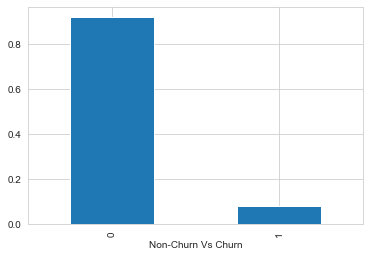

In [247]:
# churn percentage
print (telecom_hcv.churn.value_counts(normalize= True))
telecom_hcv.churn.value_counts(normalize= True).plot.bar()
plt.xlabel('Non-Churn Vs Churn')
plt.show()

Almost 8% churn cases are present in given data.

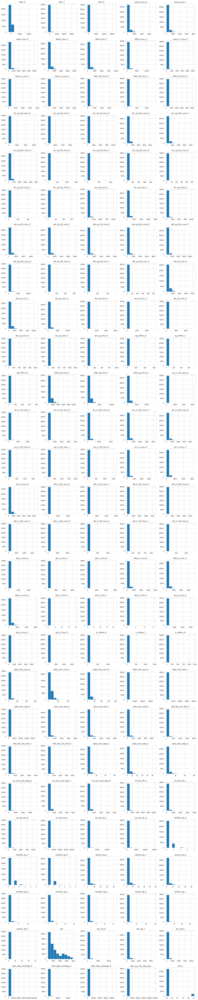

In [248]:
# checking spread and frequency of numerical data
telecom_hcv.hist(bins=10,figsize=(20,140), layout=(35,5));

A single tall bar on left side and smaller bar on right side can be seen in many columns. This represents outliers are present in data. 

In [249]:
# outlier treatment
def outlier_remove(column):
    sigma = telecom_hcv[column].std()
    mu =  telecom_hcv[column].mean()
    floor, ceil = mu - 3* sigma , mu + 3* sigma

    telecom_hcv[column] = telecom_hcv[column].clip(floor, ceil)

In [250]:
telecom_hcv.dtypes

last_date_of_month_7     datetime64[ns]
last_date_of_month_8     datetime64[ns]
arpu_6                          float64
arpu_7                          float64
arpu_8                          float64
onnet_mou_6                     float64
onnet_mou_7                     float64
onnet_mou_8                     float64
offnet_mou_6                    float64
offnet_mou_7                    float64
offnet_mou_8                    float64
roam_ic_mou_6                   float64
roam_ic_mou_7                   float64
roam_ic_mou_8                   float64
roam_og_mou_6                   float64
roam_og_mou_7                   float64
roam_og_mou_8                   float64
loc_og_t2t_mou_6                float64
loc_og_t2t_mou_7                float64
loc_og_t2t_mou_8                float64
loc_og_t2m_mou_6                float64
loc_og_t2m_mou_7                float64
loc_og_t2m_mou_8                float64
loc_og_t2f_mou_6                float64
loc_og_t2f_mou_7                float64


In [251]:
# checking cols having binary values only
double_unique_columns = telecom_hcv.nunique()[telecom_hcv.nunique()==2]
exclusion_list = list(double_unique_columns.keys())  + list(telecom_hcv.columns[telecom_hcv.dtypes== 'datetime64[ns]'])

# columns which are having more than 2 unique values
outlier_cols= [item for item in list(telecom_hcv.columns) if item not in exclusion_list]

In [252]:
# outlier capping for columns having more than 2 values
for col in outlier_cols:
    outlier_remove(col)

Outliers more than +/- 3 standard deviation away have been removed from variables.

<AxesSubplot:xlabel='churn', ylabel='aon'>

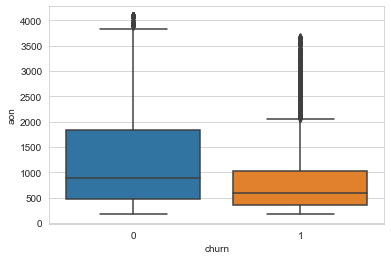

In [253]:
# age on network for churn vs non churn cases
sns.boxplot(x='churn', y='aon', data=telecom_hcv)

**Conclusion**:Age on network for churner is slightly lower than of Non-Churners.

In [254]:
# comparison churners vs non-churners
def churn_vs_nonchurn(feature):
    fig, ax = plt.subplots(figsize=(7,4))
    df=telecom_hcv.groupby(['churn'])[[feature+'_6',feature+'_7',feature+'_8']].mean().T
    plt.plot(df)
    ax.set_xticklabels(['Jun','Jul','Aug'])
    ## Add legend
    plt.legend(['Non-Churn', 'Churn'])
    # Add titles
    plt.title("Avg. "+feature+" v/s Month", loc='left', fontsize=12, fontweight=0, color='red')
    plt.xlabel("Month")
    plt.ylabel("Avg. "+feature+" MOU")
    plt.show()

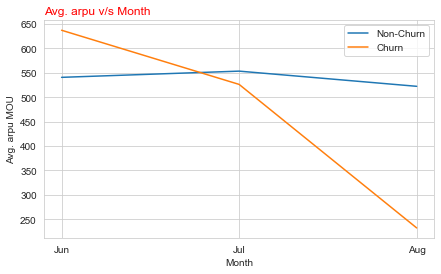

In [255]:
#average revenue per user
churn_vs_nonchurn('arpu')

**Insights:** Average ARPU for churners decreases significantly for non-churners.

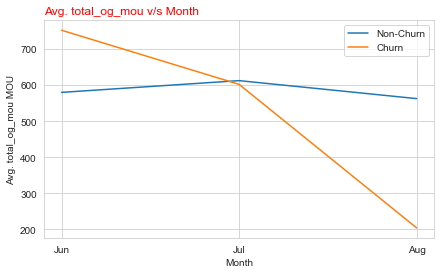

In [256]:
# total outgoing minutes of usage
churn_vs_nonchurn('total_og_mou')

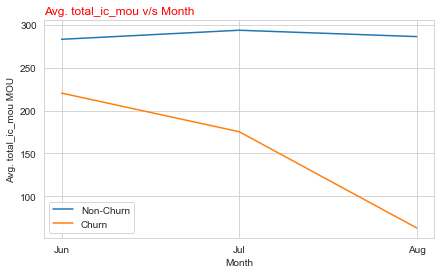

In [257]:
# total incoming minutes of usage
churn_vs_nonchurn('total_ic_mou')

**Insights**

Churners Avg. Incoming/Outgoing MOU's drops drastically after the 2nd month,Jul.While the non-churners Avg. MOU's remains consistant and stable with each month.Therefore, users MOU is a key feature to predict churn.

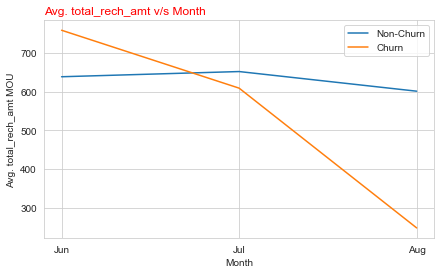

In [258]:
churn_vs_nonchurn('total_rech_amt')

**Insights**: Total recharge amount drops for churners in action month and remains stable for non-churners.

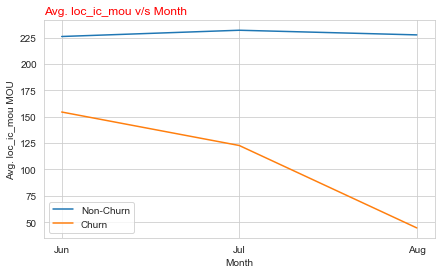

In [259]:
# local incoming MOU
churn_vs_nonchurn('loc_ic_mou')

In [260]:
telecom_hcv.describe()

,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,...,vol_2g_mb_8,vol_3g_mb_6,vol_3g_mb_7,vol_3g_mb_8,monthly_2g_6,monthly_2g_7,monthly_2g_8,sachet_2g_6,sachet_2g_7,sachet_2g_8,monthly_3g_6,monthly_3g_7,monthly_3g_8,sachet_3g_6,sachet_3g_7,sachet_3g_8,aon,vbc_3g_8,vbc_3g_7,vbc_3g_6,total_data_recharge_6,total_data_recharge_7,total_data_recharge_8,6th_and_7th_total_amt,churn
count,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,...,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000,29953.000000
mean,548.514161,551.188115,498.725003,244.617463,251.474623,216.847412,358.765330,362.186397,319.502304,12.335785,9.182920,9.227090,20.609724,14.993929,14.919463,73.510839,74.252178,68.057578,154.648786,155.239208,144.046150,5.470830,5.552123,5.066104,1.309164,...,92.299010,311.692255,335.001173,317.065576,0.162889,0.170845,0.143222,0.977953,1.128668,0.962047,0.197247,0.206223,0.189651,0.162959,0.174389,0.148880,1209.176834,152.901075,161.490743,141.747908,405.936521,466.737532,403.524488,2195.449688,0.081227
std,356.773582,361.289210,384.542031,371.778970,387.930190,354.977569,405.395769,413.714497,386.646417,41.771560,35.662871,35.333077,66.938134,52.522425,53.654116,133.846677,136.408766,126.810670,199.816097,197.268716,190.469544,12.771760,12.826603,11.764153,3.697015,...,216.480610,631.771210,654.265910,646.348058,0.387610,0.400666,0.360171,2.075421,2.317614,2.067717,0.492551,0.515782,0.490382,0.537621,0.590109,0.557765,957.130901,321.524142,339.295657,310.569347,815.344279,905.128447,893.640984,1698.728974,0.273188
min,-823.784610,-878.924945,-945.808000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,180.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,957.000000,0.000000
25%,310.142000,310.071000,231.615000,17.090000,16.040000,10.440000,71.610000,69.980000,46.760000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,4.380000,4.630000,2.540000,19.210000,20.490000,13.130000,0.000000,0.000000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,460.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,1208.000000,0.000000
50%,482.354000,481.496000,427.604000,84.640000,82.830000,65.660000,222.560000,220.040000,182.840000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,24.360000,24.680000,20.740000,77.260000,78.990000,67.790000,0.000000,0.100000,0.000000,0.000000,...,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,846.000000,0.000000,0.000000,0.000000,92.000000,100.000000,25.000000,1601.000000,0.000000
75%,700.240000,698.829000,661.753000,290.490000,290.540000,240.630000,487.910000,494.030000,438.860000,0.000000,0.000000,0.000000,0.000000,0.000000,0.000000,78.060000,78.510000,72.130000,2

In [261]:
#find the last recharge date
telecom_hcv['last_recharge_dt'] = telecom_hcv[['date_of_last_rech_6', 'date_of_last_rech_7', 'date_of_last_rech_8']].max(axis=1)

In [262]:
telecom_hcv[['date_of_last_rech_6', 'date_of_last_rech_7', 'date_of_last_rech_8', 'last_recharge_dt']]

,date_of_last_rech_6,date_of_last_rech_7,date_of_last_rech_8,last_recharge_dt
0,2014-06-21,2014-07-16,2014-08-08,2014-08-08
7,2014-06-27,2014-07-25,2014-08-26,2014-08-26
8,2014-06-25,2014-07-31,2014-08-30,2014-08-30
21,2014-06-30,2014-07-31,2014-08-31,2014-08-31
23,2014-06-18,2014-07-07,2014-08-24,2014-08-24
33,2014-06-30,2014-07-30,2014-08-26,2014-08-26
38,2014-06-30,2014-07-28,2014-08-24,2014-08-24
41,2014-06-24,2014-07-22,2014-08-31,2014-08-31
48,2014-06-29,2014-07-23,2014-08-28,2014-08-28
53,2014-06-29,2014-07-31,2014-08-26,2014-08-26


In [263]:
#Assuming model is being run on last date of month 8, find no. of days since last recharge
telecom_hcv['days_since_last_recharge'] = telecom_hcv['last_date_of_month_8'] - telecom_hcv['last_recharge_dt']
telecom_hcv['days_since_last_recharge'] = pd.to_numeric(telecom_hcv['days_since_last_recharge'].dt.days, downcast='integer')

In [264]:
#checking days since last recharge
telecom_hcv[['last_date_of_month_8', 'last_recharge_dt', 'days_since_last_recharge']]

,last_date_of_month_8,last_recharge_dt,days_since_last_recharge
0,2014-08-31,2014-08-08,23
7,2014-08-31,2014-08-26,5
8,2014-08-31,2014-08-30,1
21,2014-08-31,2014-08-31,0
23,2014-08-31,2014-08-24,7
33,2014-08-31,2014-08-26,5
38,2014-08-31,2014-08-24,7
41,2014-08-31,2014-08-31,0
48,2014-08-31,2014-08-28,3
53,2014-08-31,2014-08-26,5


In [265]:
#exclude datetime columns
telecom_hcv = telecom_hcv.select_dtypes(exclude=['datetime64[ns]'])

In [266]:
# from good and action phase deriving percentage change in action months.(action month data - good month data)/ (good month data)
def good_vs_action_phase(text):
    col_1 =text+'_6'
    col_2 = text+'_7'
    col_3 =text+'_8'
    
    col_4 =text+'_pc_change'
    # percentage change

    telecom_hcv[col_4] = ((telecom_hcv[col_3] - (telecom_hcv[col_1] + telecom_hcv[col_2])/2 )/(telecom_hcv[col_1] + telecom_hcv[col_2]).apply(lambda x:0.1 if x<0.1 else x))*100
    

 So we will be creating list of text based on column names. This list can be passed to the custom function "good_vs_action_phase" to create derived varaibles for comparison between good and action phase. 

In [267]:
# June month columns 
June_list = [s for s in list(telecom_hcv.columns) if '_6' in s]
text_list = [s.rstrip('_6') for s in June_list]
text_list

['arpu',
 'onnet_mou',
 'offnet_mou',
 'roam_ic_mou',
 'roam_og_mou',
 'loc_og_t2t_mou',
 'loc_og_t2m_mou',
 'loc_og_t2f_mou',
 'loc_og_t2c_mou',
 'loc_og_mou',
 'std_og_t2t_mou',
 'std_og_t2m_mou',
 'std_og_t2f_mou',
 'std_og_mou',
 'isd_og_mou',
 'spl_og_mou',
 'og_others',
 'total_og_mou',
 'loc_ic_t2t_mou',
 'loc_ic_t2m_mou',
 'loc_ic_t2f_mou',
 'loc_ic_mou',
 'std_ic_t2t_mou',
 'std_ic_t2m_mou',
 'std_ic_t2f_mou',
 'std_ic_mou',
 'total_ic_mou',
 'spl_ic_mou',
 'isd_ic_mou',
 'ic_others',
 'total_rech_num',
 'total_rech_amt',
 'max_rech_amt',
 'last_day_rch_amt',
 'total_rech_data',
 'av_rech_amt_data',
 'vol_2g_mb',
 'vol_3g_mb',
 'monthly_2g',
 'sachet_2g',
 'monthly_3g',
 'sachet_3g',
 'vbc_3g',
 'total_data_recharge']

In [268]:
# creating derived variables for good vs action phase
for text in text_list:
    good_vs_action_phase(text)
    

In [269]:
#find percentage difference between total reachrge amount for 8th month and average of 6th and 7th months

telecom_hcv['8th_total_amt'] = telecom_hcv['total_rech_amt_8'] + telecom_hcv['total_data_recharge_8']
telecom_hcv['total_amt_action_minus_good'] = ((telecom_hcv['8th_total_amt'] - telecom_hcv['6th_and_7th_total_amt']/2)/(telecom_hcv['6th_and_7th_total_amt']/2).apply(lambda x:0.1 if x<0.1 else x))*100  



In [270]:
telecom_hcv_copy = telecom_hcv.copy()

In [67]:
#drop these columns as we're only interested in the difference
telecom_hcv.drop(['6th_and_7th_total_amt'], axis =1, inplace =True)

In [68]:
telecom_hcv.head()

,arpu_6,arpu_7,arpu_8,onnet_mou_6,onnet_mou_7,onnet_mou_8,offnet_mou_6,offnet_mou_7,offnet_mou_8,roam_ic_mou_6,roam_ic_mou_7,roam_ic_mou_8,roam_og_mou_6,roam_og_mou_7,roam_og_mou_8,loc_og_t2t_mou_6,loc_og_t2t_mou_7,loc_og_t2t_mou_8,loc_og_t2m_mou_6,loc_og_t2m_mou_7,loc_og_t2m_mou_8,loc_og_t2f_mou_6,loc_og_t2f_mou_7,loc_og_t2f_mou_8,loc_og_t2c_mou_6,...,loc_ic_mou_pc_change,std_ic_t2t_mou_pc_change,std_ic_t2m_mou_pc_change,std_ic_t2f_mou_pc_change,std_ic_mou_pc_change,total_ic_mou_pc_change,spl_ic_mou_pc_change,isd_ic_mou_pc_change,ic_others_pc_change,total_rech_num_pc_change,total_rech_amt_pc_change,max_rech_amt_pc_change,last_day_rch_amt_pc_change,total_rech_data_pc_change,av_rech_amt_data_pc_change,vol_2g_mb_pc_change,vol_3g_mb_pc_change,monthly_2g_pc_change,sachet_2g_pc_change,monthly_3g_pc_change,sachet_3g_pc_change,vbc_3g_pc_change,total_data_recharge_pc_change,8th_total_amt,total_amt_action_minus_good
0,197.385,214.816,213.803000,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,...,5440.000000,0.000000,0.000000,0.000000,0.000000,5440.000000,0.0,0.000000,0.00000,-21.428571,-8.957655,0.000000,0.00000,0.0,0.000000,-31.717011,-3.224086,0.0,0.0,0.0,0.0,-19.960474,0.000000,504.000000,-9.838998
7,1069.180,1349.850,2015.299135,57.84,54.68,52.29,453.43,567.16,325.91,16.23,33.49,31.64,23.74,12.59,38.06,51.39,31.38,40.28,308.63,447.38,162.28,62.13,55.14,53.23,0.0,...,-25.988048,12.376847,14.702651,-24.302904,4.844183,-13.804137,-50.0,140.415913,-1.05076,20.000000,52.073192,-1.846852,528185.00554,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,101.469045,0.000000,2419.134659,104.146385
8,378.721,492.223,137.362000,413.69,351.03,35.08,94.66,80.63,136.48,0.00,0.00,0.00,0.00,0.00,0.00,297.13,217.59,12.49,80.96,70.58,50.54,0.00,0.00,0.00,0.0,...,-34.999050,-32.758621,-47.548095,0.000000,-47.231451,-37.502833,0.0,0.000000,0.00000,-15.000000,-38.439306,-37.704918,-30.00000,100.0,-11.016949,-49.991573,-48.410014,-50.0,250.0,0.0,0.0,-47.963807,8.474576,327.000000,-53.017241
21,514.453,597.753,637.760000,102.41,132.11,85.14,757.93,896.68,983.39,0.00,0.00,0.00,0.00,0.00,0.00,4.48,6.16,23.34,91.81,87.93,104.81,0.75,0.00,1.58,0.0,...,24.696024,-49.101796,46.053625,0.000000,30.916091,27.007493,0.0,0.000000,0.00000,6.250000,6.093750,0.000000,50.00000,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,718.000000,12.187500
23,74.350,193.897,366.966000,48.96,50.66,33.58,85.41,89.36,205.89,0.00,0.00,0.00,0.00,0.00,0.00,48.96,50.66,33.58,82.94,83.01,148.56,0.00,0.00,0.00,0.0,...,27.037521,2573.529412,203.521940,0.000000,271.312395,37.111280,0.0,-36.751683,194.11215,0.000000,46.696035,50.000000,-50.00000,50.0,25.842697,-47.916667,118.575673,0.0,0.0,0.0,1000.0,27.998457,25.842697,979.000000,67.924528


In [69]:
telecom_hcv[['std_og_mou_6', 'std_og_mou_7', 'std_og_mou_8', 'std_og_mou_pc_change']].head()

,std_og_mou_6,std_og_mou_7,std_og_mou_8,std_og_mou_pc_change
0,0.00,0.00,0.00,0.000000
7,60.86,75.14,77.84,7.235294
8,130.26,143.48,98.28,-14.097319
21,763.29,934.69,938.79,5.288637
23,2.36,6.35,39.61,404.764638


In [70]:
# dropping good phase columns from which derived columns have been created
for text in text_list:
    telecom_hcv.drop([text+'_6', text+'_7'], axis =1, inplace= True)

In [71]:
telecom_hcv.head()

,arpu_8,onnet_mou_8,offnet_mou_8,roam_ic_mou_8,roam_og_mou_8,loc_og_t2t_mou_8,loc_og_t2m_mou_8,loc_og_t2f_mou_8,loc_og_t2c_mou_8,loc_og_mou_8,std_og_t2t_mou_8,std_og_t2m_mou_8,std_og_t2f_mou_8,std_og_mou_8,isd_og_mou_8,spl_og_mou_8,og_others_8,total_og_mou_8,loc_ic_t2t_mou_8,loc_ic_t2m_mou_8,loc_ic_t2f_mou_8,loc_ic_mou_8,std_ic_t2t_mou_8,std_ic_t2m_mou_8,std_ic_t2f_mou_8,...,loc_ic_mou_pc_change,std_ic_t2t_mou_pc_change,std_ic_t2m_mou_pc_change,std_ic_t2f_mou_pc_change,std_ic_mou_pc_change,total_ic_mou_pc_change,spl_ic_mou_pc_change,isd_ic_mou_pc_change,ic_others_pc_change,total_rech_num_pc_change,total_rech_amt_pc_change,max_rech_amt_pc_change,last_day_rch_amt_pc_change,total_rech_data_pc_change,av_rech_amt_data_pc_change,vol_2g_mb_pc_change,vol_3g_mb_pc_change,monthly_2g_pc_change,sachet_2g_pc_change,monthly_3g_pc_change,sachet_3g_pc_change,vbc_3g_pc_change,total_data_recharge_pc_change,8th_total_amt,total_amt_action_minus_good
0,213.803000,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.16,4.13,1.15,5.44,0.00,0.00,0.00,...,5440.000000,0.000000,0.000000,0.000000,0.000000,5440.000000,0.0,0.000000,0.00000,-21.428571,-8.957655,0.000000,0.00000,0.0,0.000000,-31.717011,-3.224086,0.0,0.0,0.0,0.0,-19.960474,0.000000,504.000000,-9.838998
7,2015.299135,52.29,325.91,31.64,38.06,40.28,162.28,53.23,0.00,255.79,12.01,49.14,16.68,77.84,10.01,6.50,0.0,350.16,27.31,121.19,39.53,188.04,30.39,141.33,22.21,...,-25.988048,12.376847,14.702651,-24.302904,4.844183,-13.804137,-50.0,140.415913,-1.05076,20.000000,52.073192,-1.846852,528185.00554,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,101.469045,0.000000,2419.134659,104.146385
8,137.362000,35.08,136.48,0.00,0.00,12.49,50.54,0.00,7.15,63.04,22.58,75.69,0.00,98.28,0.00,10.23,0.0,171.56,0.31,15.48,0.00,15.79,0.10,0.65,0.00,...,-34.999050,-32.758621,-47.548095,0.000000,-47.231451,-37.502833,0.0,0.000000,0.00000,-15.000000,-38.439306,-37.704918,-30.00000,100.0,-11.016949,-49.991573,-48.410014,-50.0,250.0,0.0,0.0,-47.963807,8.474576,327.000000,-53.017241
21,637.760000,85.14,983.39,0.00,0.00,23.34,104.81,1.58,0.00,129.74,61.79,876.99,0.00,938.79,0.00,0.00,0.0,1068.54,19.54,129.16,10.39,159.11,0.18,101.74,0.00,...,24.696024,-49.101796,46.053625,0.000000,30.916091,27.007493,0.0,0.000000,0.00000,6.250000,6.093750,0.000000,50.00000,0.0,0.000000,0.000000,0.000000,0.0,0.0,0.0,0.0,0.000000,0.000000,718.000000,12.187500
23,366.966000,33.58,205.89,0.00,0.00,33.58,148.56,0.00,17.71,182.14,0.00,39.61,0.00,39.61,0.00,17.71,0.0,239.48,76.64,146.84,0.71,224.21,13.38,43.91,0.00,...,27.037521,2573.529412,203.521940,0.000000,271.312395,37.111280,0.0,-36.751683,194.11215,0.000000,46.696035,50.000000,-50.00000,50.0,25.842697,-47.916667,118.575673,0.0,0.0,0.0,1000.0,27.998457,25.842697,979.000000,67.924528


In [72]:
telecom_hcv.shape

(29953, 93)

for var in list(telecom_hcv.columns):
    sns.boxplot(x='churn', y=var, data=telecom_hcv)
    plt.show()

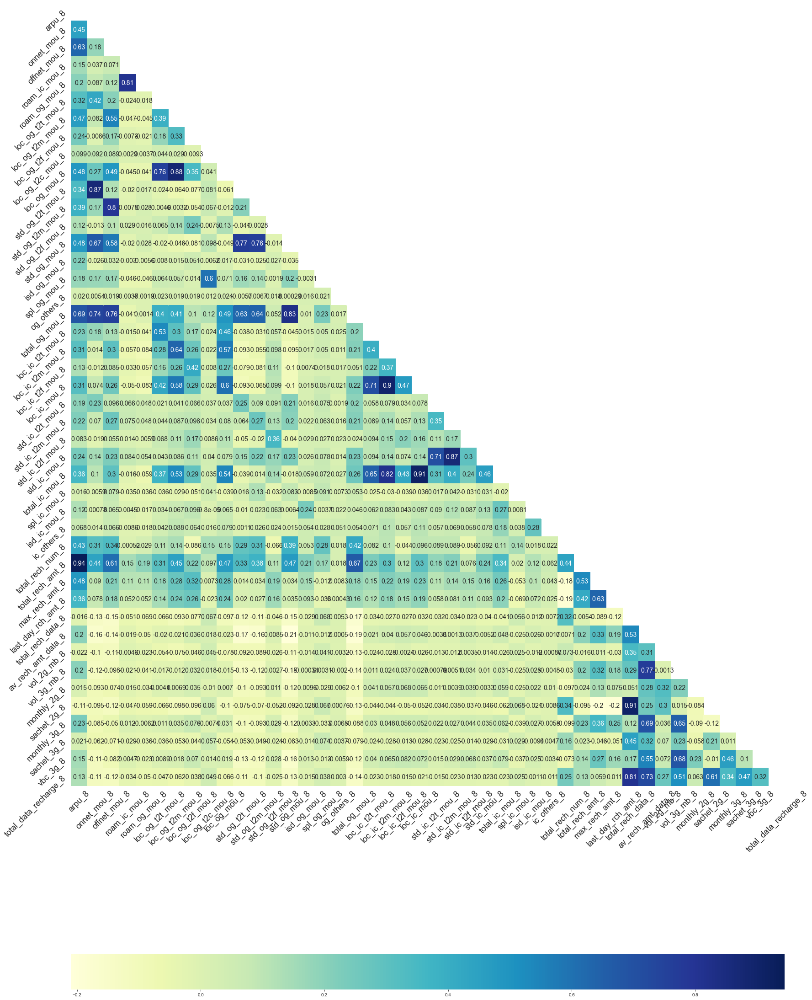

In [73]:
# plotting heatmap of correlation for action month variables
plt.figure(figsize=(28,45))
Aug_list = [s for s in list(telecom_hcv.columns) if '_8' in s]
matrix = np.triu(telecom_hcv[Aug_list].corr())

res=sns.heatmap(telecom_hcv[Aug_list].corr(),cmap='YlGnBu',annot=True,annot_kws={"size": 14},cbar_kws= {'orientation': 'horizontal'}, 
                mask=matrix)
res.set_xticklabels(res.get_xmajorticklabels(), fontsize = 18, rotation=45)
res.set_yticklabels(res.get_ymajorticklabels(), fontsize = 18, rotation=45)
plt.show()

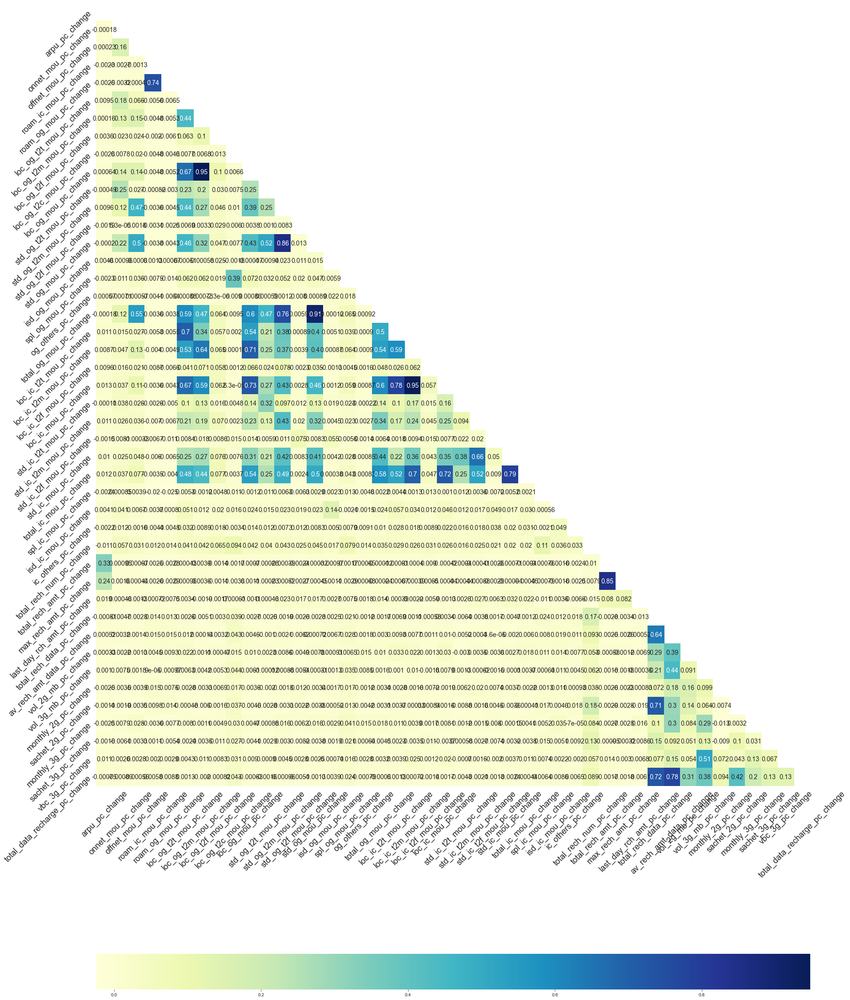

In [74]:
# plotting heatmap of correlation for percentage change varaibles
plt.figure(figsize=(28,45))
change_list = [s for s in list(telecom_hcv.columns) if '_pc_change' in s]
matrix = np.triu(telecom_hcv[change_list].corr())

res=sns.heatmap(telecom_hcv[change_list].corr(),cmap='YlGnBu',annot=True,annot_kws={"size": 14},cbar_kws= {'orientation': 'horizontal'}, 
                mask=matrix)
res.set_xticklabels(res.get_xmajorticklabels(), fontsize = 18, rotation=45)
res.set_yticklabels(res.get_ymajorticklabels(), fontsize = 18, rotation=45)
plt.show()

In [75]:
corr_matrix= telecom_hcv.corr().abs()
# Select triangle of correlation matrix
upper = corr_matrix.where(np.triu(np.ones(corr_matrix.shape), k=1).astype(np.bool))

# Find features with correlation greater than 0.85
corr_greater_than_85=[column for column in upper.columns if any(upper[column] > 0.85)]
corr_greater_than_85

['loc_og_mou_8',
 'std_og_t2t_mou_8',
 'loc_ic_mou_8',
 'std_ic_mou_8',
 'total_ic_mou_8',
 'total_rech_amt_8',
 'sachet_2g_8',
 'loc_og_mou_pc_change',
 'std_og_mou_pc_change',
 'total_og_mou_pc_change',
 'loc_ic_mou_pc_change',
 '8th_total_amt']

Variables are correlated so We will use PCA before model building.

## Model Building
Let's start by splitting our data into a training set and a test set.

### Splitting Data into Training and Test Sets

In [76]:
# Putting feature variable to X
X = telecom_hcv.drop(['churn'],axis=1)

# Putting response variable to y
y = telecom_hcv['churn']

y.head()

0     1
7     1
8     0
21    0
23    0
Name: churn, dtype: int64

In [77]:
# Splitting the data into train and test
X_train, X_test, y_train, y_test = train_test_split(X,y, train_size=0.8,test_size=0.2,random_state=100)

In [78]:
X_train.head()

,arpu_8,onnet_mou_8,offnet_mou_8,roam_ic_mou_8,roam_og_mou_8,loc_og_t2t_mou_8,loc_og_t2m_mou_8,loc_og_t2f_mou_8,loc_og_t2c_mou_8,loc_og_mou_8,std_og_t2t_mou_8,std_og_t2m_mou_8,std_og_t2f_mou_8,std_og_mou_8,isd_og_mou_8,spl_og_mou_8,og_others_8,total_og_mou_8,loc_ic_t2t_mou_8,loc_ic_t2m_mou_8,loc_ic_t2f_mou_8,loc_ic_mou_8,std_ic_t2t_mou_8,std_ic_t2m_mou_8,std_ic_t2f_mou_8,...,loc_ic_mou_pc_change,std_ic_t2t_mou_pc_change,std_ic_t2m_mou_pc_change,std_ic_t2f_mou_pc_change,std_ic_mou_pc_change,total_ic_mou_pc_change,spl_ic_mou_pc_change,isd_ic_mou_pc_change,ic_others_pc_change,total_rech_num_pc_change,total_rech_amt_pc_change,max_rech_amt_pc_change,last_day_rch_amt_pc_change,total_rech_data_pc_change,av_rech_amt_data_pc_change,vol_2g_mb_pc_change,vol_3g_mb_pc_change,monthly_2g_pc_change,sachet_2g_pc_change,monthly_3g_pc_change,sachet_3g_pc_change,vbc_3g_pc_change,total_data_recharge_pc_change,8th_total_amt,total_amt_action_minus_good
56958,1246.236,0.00,197.01,0.000000,0.00000,0.00,87.83,0.00,0.00,87.83,0.00,109.18,0.00,109.18,0.0,0.00,0.0,197.01,0.00,31.44,0.00,31.44,0.70,1.03,0.00,...,-15.732970,700.000000,-44.824121,0.00000,-41.306533,-12.227993,0.0,9000.000000,0.000000,8.620690,98.383838,271.078431,1270.462514,200.000000,204.174336,744.827586,102.905289,39.469292,0.0,1000.000000,2000.0,42.377274,893.548387,6734.0,770.025840
45202,1047.471,39.16,1051.51,235.049813,334.28816,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.0,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,...,0.000000,0.000000,0.000000,0.00000,0.000000,0.000000,0.0,0.000000,0.000000,33.870968,2.574103,-1.851852,-1.851852,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,1348.0,5.148206
45991,553.092,54.88,423.91,7.460000,21.74000,34.86,375.96,2.58,0.00,413.41,17.79,7.60,8.49,33.89,0.0,9.73,0.0,457.04,29.06,195.99,19.33,244.39,0.00,0.00,0.66,...,-3.877366,-50.000000,-50.000000,-48.01444,-49.327080,-10.915330,0.0,0.000000,380.000000,0.000000,-16.866118,-8.333333,-45.272727,0.000000,0.000000,0.000000,0.000000,0.000000,0.0,0.000000,0.0,0.000000,0.000000,443.0,-33.732236
24597,595.990,136.41,68.18,7.580000,12.30000,25.26,61.56,0.00,0.95,86.83,101.43,2.26,0.00,103.69,0.0,1.76,0.0,192.29,19.36,222.08,12.33,253.78,6.88,0.23,0.00,...,263.502162,-17.144222,-46.728307,0.00000,-24.588992,190.022030,250.0,330.000000,0.000000,21.428571,-7.611386,-35.576923,-12.500000,30.000000,0.505051,55.583315,0.000000,0.000000,-10.0,0.000000,2000.0,0.000000,30.321285,1085.0,2.649007
33873,213.804,0.00,0.00,0.000000,0.00000,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.00,0.0,0.00,0.0,0.00,1.55,0.98,0.00,2.53,0.00,0.00,0.00,...,27.134146,-50.000000,-50.000000,-5.00000,-50.000000,-47.418623,70.0,-44.651432,1640.909091,-7.142857,0.000000,0.000000,-50.000000,-16.666667,-16.666667,14.767748,-5.795564,0.000000,0.0,-16.666667,0.0,64.307132,-30.000000,504.0,-42.857143


## SMOTE for Class imbalance

In [79]:
from imblearn.over_sampling import SMOTE
from collections import Counter

counter = Counter(y_train)
print('Before',counter)
# oversampling the train dataset using SMOTE
smt = SMOTE()
#X_train, y_train = smt.fit_resample(X_train, y_train)
X_train_sm, y_train_sm = smt.fit_resample(X_train, y_train)

counter = Counter(y_train_sm)
print('After',counter)

Before Counter({0: 21996, 1: 1966})
After Counter({0: 21996, 1: 21996})


In [80]:
#scaling variables
scaler = StandardScaler()

X_train_sm[X_train_sm.columns] =scaler.fit_transform(X_train_sm[X_train_sm.columns])
X_test[X_test.columns] =scaler.transform(X_test[X_test.columns])

X_train_sm.head()

,arpu_8,onnet_mou_8,offnet_mou_8,roam_ic_mou_8,roam_og_mou_8,loc_og_t2t_mou_8,loc_og_t2m_mou_8,loc_og_t2f_mou_8,loc_og_t2c_mou_8,loc_og_mou_8,std_og_t2t_mou_8,std_og_t2m_mou_8,std_og_t2f_mou_8,std_og_mou_8,isd_og_mou_8,spl_og_mou_8,og_others_8,total_og_mou_8,loc_ic_t2t_mou_8,loc_ic_t2m_mou_8,loc_ic_t2f_mou_8,loc_ic_mou_8,std_ic_t2t_mou_8,std_ic_t2m_mou_8,std_ic_t2f_mou_8,...,loc_ic_mou_pc_change,std_ic_t2t_mou_pc_change,std_ic_t2m_mou_pc_change,std_ic_t2f_mou_pc_change,std_ic_mou_pc_change,total_ic_mou_pc_change,spl_ic_mou_pc_change,isd_ic_mou_pc_change,ic_others_pc_change,total_rech_num_pc_change,total_rech_amt_pc_change,max_rech_amt_pc_change,last_day_rch_amt_pc_change,total_rech_data_pc_change,av_rech_amt_data_pc_change,vol_2g_mb_pc_change,vol_3g_mb_pc_change,monthly_2g_pc_change,sachet_2g_pc_change,monthly_3g_pc_change,sachet_3g_pc_change,vbc_3g_pc_change,total_data_recharge_pc_change,8th_total_amt,total_amt_action_minus_good
0,2.277129,-0.523954,-0.092704,-0.317263,-0.346487,-0.422823,-0.020658,-0.341767,-0.314863,-0.221404,-0.395280,0.019055,-0.187898,-0.249378,-0.1033,-0.421361,-0.037175,-0.325048,-0.481587,-0.396083,-0.372108,-0.487617,-0.282362,-0.354084,-0.209925,...,-0.028325,0.164962,-0.070492,-0.104428,-0.049523,-0.025621,0.070350,1.988009,-0.092934,1.019143,-0.007769,0.019170,-0.072900,0.379630,-0.114024,-0.043831,-0.079912,0.195333,-0.149189,6.169645,10.248549,-0.089611,-0.076899,6.511741,10.490603
1,1.760842,-0.396803,2.420041,5.686142,5.072606,-0.422823,-0.575685,-0.341767,-0.314863,-0.584743,-0.395280,-0.425423,-0.187898,-0.502491,-0.1033,-0.421361,-0.037175,-0.690629,-0.481587,-0.616985,-0.372108,-0.637282,-0.310220,-0.378473,-0.209925,...,-0.025745,-0.073272,-0.058623,-0.104428,-0.040449,-0.024450,0.070350,-0.090697,-0.092934,2.057861,-0.019651,-0.021892,-0.108625,-0.122851,-0.122631,-0.068544,-0.080876,-0.105249,-0.149189,-0.101207,-0.101514,-0.090344,-0.089420,0.726188,0.511650
2,0.476706,-0.345761,0.574518,-0.126728,0.005937,-0.079027,1.800130,-0.073404,-0.314863,1.125469,-0.325606,-0.394483,2.182036,-0.423924,-0.1033,0.571699,-0.037175,0.157475,-0.079592,0.760069,0.552925,0.526093,-0.310220,-0.378473,-0.098560,...,-0.026381,-0.090289,-0.071862,-0.135985,-0.051285,-0.025495,0.070350,-0.090697,0.153639,0.664515,-0.022062,-0.022867,-0.109844,-0.122851,-0.122631,-0.068544,-0.080876,-0.105249,-0.149189,-0.101207,-0.101514,-0.090344,-0.089420,-0.245948,0.004398
3,0.588133,-0.081036,-0.471542,-0.123663,-0.147093,-0.173704,-0.186667,-0.341767,-0.042822,-0.225541,0.001966,-0.416223,-0.187898,-0.262106,-0.1033,-0.241732,-0.037175,-0.333807,-0.213774,0.943381,0.217941,0.570793,-0.036424,-0.373027,-0.209925,...,0.017475,-0.079107,-0.070996,-0.104428,-0.045851,-0.006241,5.370662,-0.014478,-0.092934,1.546019,-0.020914,-0.026966,-0.108924,-0.047479,-0.122610,-0.066699,-0.080876,-0.105249,-0.170539,-0.101207,10.248549,-0.090344,-0.088995,0.443678,0.479044
4,-0.404585,-0.523954,-0.672033,-0.317263,-0.346487,-0.422823,-0.575685,-0.341767,-0.314863,-0.584743,-0.395280,-0.425423,-0.187898,-0.502491,-0.1033,-0.421361,-0.037175,-0.690629,-0.460145,-0.610099,-0.372108,-0.625238,-0.310220,-0.378473,-0.209925,...,-0.021294,-0.090289,-0.071862,-0.107714,-0.051433,-0.028993,1.554437,-0.101010,0.971811,0.370680,-0.019970,-0.021613,-0.109977,-0.164725,-0.123334,-0.068054,-0.080930,-0.105249,-0.149189,-0.205721,-0.101514,-0.089232,-0.089840,-0.180423,-0.114650


## PCA

In [81]:
pca = PCA(0.95)

In [82]:
pca.fit(X_train_sm)

PCA(n_components=0.95)

#### Components from the PCA

In [83]:
pca.components_

array([[ 0.25522692,  0.14257579,  0.20055947, ...,  0.05487444,
         0.21356786,  0.21178803],
       [-0.02862491, -0.01960118, -0.01971556, ..., -0.00559743,
        -0.02652068, -0.02273778],
       [-0.06409556, -0.18740479, -0.17462932, ...,  0.06221457,
         0.22735475,  0.15115017],
       ...,
       [ 0.01133724,  0.0108076 ,  0.01513275, ..., -0.19928103,
         0.06511128,  0.06053258],
       [ 0.01069281, -0.00740846, -0.00533073, ..., -0.02464733,
         0.00836677, -0.00340601],
       [ 0.00500831,  0.01020603,  0.00656122, ...,  0.18084553,
         0.17295043,  0.17830475]])

Looking at the explained variance ratio for each component

In [84]:
pca.explained_variance_ratio_

array([0.11841225, 0.07759582, 0.05824782, 0.04627253, 0.03386273,
       0.03162319, 0.02586354, 0.02426087, 0.02202916, 0.02155103,
       0.02142749, 0.01895216, 0.01816998, 0.0174771 , 0.01722488,
       0.01684546, 0.01656069, 0.01529832, 0.01476316, 0.01412713,
       0.01357517, 0.01345547, 0.01261924, 0.01197641, 0.01173858,
       0.01158442, 0.01116203, 0.01101626, 0.01075147, 0.01070155,
       0.01049594, 0.00999121, 0.00990322, 0.00973991, 0.0093745 ,
       0.00920101, 0.00898608, 0.00889993, 0.00867813, 0.00850535,
       0.00834254, 0.007947  , 0.00758815, 0.00739961, 0.00713345,
       0.00683896, 0.00662035, 0.00629362, 0.00591374, 0.0058851 ,
       0.00570025, 0.00558952, 0.00530347, 0.00506446, 0.00493754,
       0.00471985, 0.00436432, 0.00422127])

Making a scree plot for the explained variance

In [85]:
var_cumu = np.cumsum(pca.explained_variance_ratio_)

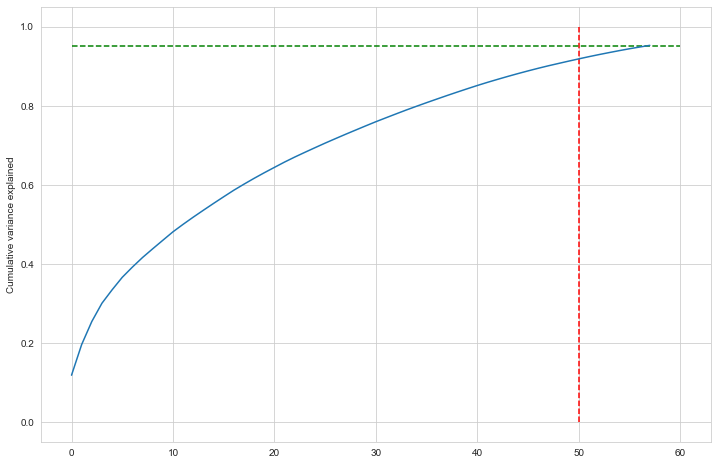

In [86]:
fig = plt.figure(figsize=[12,8])
plt.vlines(x=50, ymax=1, ymin=0, colors="r", linestyles="--")
plt.hlines(y=0.95, xmax=60, xmin=0, colors="g", linestyles="--")
plt.plot(var_cumu)
plt.ylabel("Cumulative variance explained")
plt.show()

In [87]:
df_train_pca = pca.fit_transform(X_train_sm)

In [88]:
df_train_pca.shape

(43992, 58)

## Logistic Regression with PCA for predictions

In [89]:
learner_pca = LogisticRegression()

In [90]:
model_pca = learner_pca.fit(df_train_pca, y_train_sm)

In [91]:
df_test_pca = pca.transform(X_test)

In [92]:
df_test_pca.shape

(5991, 58)

In [93]:
pred_probs_test = model_pca.predict_proba(df_test_pca)[:,1]

In [94]:
"{:2.2}".format(metrics.roc_auc_score(y_test, pred_probs_test))

'0.89'

In [95]:
# evaluating model performance and storing results for comparison
model = list()
resample = list()
precision = list()
recall = list()
F1score = list()
AUCROC = list()

# model performance evaluation
def test_eval(clf_model, X_test, y_test, algo=None, sampling=None):
    # Test set prediction
    y_prob=clf_model.predict_proba(X_test)
    y_pred=clf_model.predict(X_test)

    print('Confusion Matrix')
    print('='*60)
    print(metrics.confusion_matrix(y_test,y_pred),"\n")
    print('Classification Report')
    print('='*60)
    print(metrics.classification_report(y_test,y_pred),"\n")
    print('AUC-ROC')
    print('='*60)
    print(metrics.roc_auc_score(y_test, y_prob[:,1]))
          
    model.append(algo)
    precision.append(metrics.precision_score(y_test,y_pred))
    recall.append(metrics.recall_score(y_test,y_pred))
    F1score.append(metrics.f1_score(y_test,y_pred))
    AUCROC.append(metrics.roc_auc_score(y_test, y_prob[:,1]))
    resample.append(sampling)

In [96]:
# model performance
test_eval(model_pca, df_test_pca, y_test, 'Logistic_Regression', 'SMOTE_PCA')

Confusion Matrix
[[4442 1082]
 [  82  385]] 

Classification Report
              precision    recall  f1-score   support

           0       0.98      0.80      0.88      5524
           1       0.26      0.82      0.40       467

    accuracy                           0.81      5991
   macro avg       0.62      0.81      0.64      5991
weighted avg       0.93      0.81      0.85      5991
 

AUC-ROC
0.8860277984950236


## Logistic Regression for predictions without handling class imbalance

In [97]:
from sklearn.linear_model import LogisticRegression

In [98]:
lr = LogisticRegression()

In [99]:
lr.fit(X_train,y_train)

LogisticRegression()

In [100]:
metrics.accuracy_score(y_test, lr.predict(X_test))

0.7190786179268903

In [101]:
test_eval(lr, X_test, y_test, 'Logistic_Regression')

Confusion Matrix
[[3909 1615]
 [  68  399]] 

Classification Report
              precision    recall  f1-score   support

           0       0.98      0.71      0.82      5524
           1       0.20      0.85      0.32       467

    accuracy                           0.72      5991
   macro avg       0.59      0.78      0.57      5991
weighted avg       0.92      0.72      0.78      5991
 

AUC-ROC
0.8633639931341066


### Random Forest for Prediction with PCA

In [102]:
# result of HPT
rf_best_pca = RandomForestClassifier(max_depth=30, max_features=5, min_samples_leaf=10,
                       n_jobs=-1, random_state=42).fit(df_train_pca, y_train_sm)

In [103]:
test_eval(rf_best_pca, df_test_pca, y_test, 'Random_Forest', 'SMOTE_PCA')

Confusion Matrix
[[5179  345]
 [ 153  314]] 

Classification Report
              precision    recall  f1-score   support

           0       0.97      0.94      0.95      5524
           1       0.48      0.67      0.56       467

    accuracy                           0.92      5991
   macro avg       0.72      0.80      0.76      5991
weighted avg       0.93      0.92      0.92      5991
 

AUC-ROC
0.8864375347907593


## XGBoost with PCA for predictions

In [104]:
xgb_cfl = xgb.XGBClassifier(n_jobs = -1,objective = 'binary:logistic')

In [105]:
# Fit the model to our train and target
xgb_cfl.fit(df_train_pca, y_train_sm)  # default 
# Get our predictions
xgb_predictions = xgb_cfl.predict(df_test_pca)

[22:20:41] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


In [106]:
xgb_predictions_prob = xgb_cfl.predict_proba(df_test_pca)
xgb_predictions_prob

array([[9.7482443e-01, 2.5175545e-02],
       [9.9995893e-01, 4.1060190e-05],
       [9.4753999e-01, 5.2459989e-02],
       ...,
       [1.3125283e-01, 8.6874717e-01],
       [9.3866664e-01, 6.1333377e-02],
       [9.9655688e-01, 3.4431347e-03]], dtype=float32)

In [107]:
metrics.accuracy_score(y_test, xgb_predictions)

0.9090302119846436

#### HPT - Grid Search

In [108]:
# A parameter grid for XGBoost
params = {
        'n_estimators' : [ 100,200], # no of trees 
        'learning_rate' : [0.01, 0.1, 0.25],  # eta
        'gamma': [0.5,1,1.5],
        }

folds = 4

model_cv = GridSearchCV(xgb_cfl, param_grid=params, scoring='recall', n_jobs=-1, cv=4, verbose=1)


%%time
model_cv.fit(df_train_pca, y_train_sm)

print('\n Best estimator:')
xgb_best = model_cv.best_estimator_ 
print(model_cv.best_estimator_)
print('\n Best recall for {0}-fold search with parameter combinations {1} is:'.format(folds, params))
print(model_cv.best_score_ )
print('\n Best hyperparameters:')
print(model_cv.best_params_)

    Grid Search CV is giving Best hyperparameters:
{'gamma': 0.5, 'learning_rate': 0.25, 'n_estimators': 200}
 
 With the best estimator as :
 
 
 XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0.5, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.25, max_delta_step=0, max_depth=6,
              min_child_weight=1, missing=nan, monotone_constraints='()',
              n_estimators=200, n_jobs=-1, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None)

In [109]:
# result of grid search CV, as it is taking lots of time in execution
xgb_best = xgb.XGBClassifier(base_score=0.5, booster='gbtree', colsample_bylevel=1,
              colsample_bynode=1, colsample_bytree=1, gamma=0.5, gpu_id=-1,
              importance_type='gain', interaction_constraints='',
              learning_rate=0.25, max_delta_step=0, max_depth=6,
              min_child_weight=1, monotone_constraints='()',
              n_estimators=200, n_jobs=-1, num_parallel_tree=1, random_state=0,
              reg_alpha=0, reg_lambda=1, scale_pos_weight=1, subsample=1,
              tree_method='exact', validate_parameters=1, verbosity=None).fit(df_train_pca, y_train_sm)

[22:21:14] WARNING: /Users/travis/build/dmlc/xgboost/src/learner.cc:1061: Starting in XGBoost 1.3.0, the default evaluation metric used with the objective 'binary:logistic' was changed from 'error' to 'logloss'. Explicitly set eval_metric if you'd like to restore the old behavior.


In [110]:
xgb_predictions_hpt = xgb_best.predict(df_test_pca)
metrics.accuracy_score(y_test, xgb_predictions_hpt)

0.9178768152228343

In [111]:
test_eval(xgb_best, df_test_pca, y_test, 'XGBoost', 'SMOTE_PCA')

Confusion Matrix
[[5201  323]
 [ 169  298]] 

Classification Report
              precision    recall  f1-score   support

           0       0.97      0.94      0.95      5524
           1       0.48      0.64      0.55       467

    accuracy                           0.92      5991
   macro avg       0.72      0.79      0.75      5991
weighted avg       0.93      0.92      0.92      5991
 

AUC-ROC
0.8793665794733356


In [112]:
# model comparison
clf_eval_df = pd.DataFrame({'model':model,
                            'resample':resample,
                            'precision':precision,
                            'recall':recall,
                            'f1-score':F1score,
                            'AUC-ROC':AUCROC})

In [113]:
# sorting by recall
clf_eval_df.sort_values(by="recall", ascending=False)

,model,resample,precision,recall,f1-score,AUC-ROC
1,Logistic_Regression,None,0.198113,0.854390,0.321644,0.863364
0,Logistic_Regression,SMOTE_PCA,0.262440,0.824411,0.398139,0.886028
2,Random_Forest,SMOTE_PCA,0.476480,0.672377,0.557726,0.886438
3,XGBoost,SMOTE_PCA,0.479871,0.638116,0.547794,0.879367


**Suggestions:**
AUC of Logistic Regression, Random Forest and XGBoost with SMOTE and PCA is quite comparable. Logistic Regression can be used if company wants to predict churner at the cost of Non-churners also being classified as churners as this model is giving high Recall but less precision.

Random Forest model is giving good Recall and Precision so we suggest this model for predictions.

## Random Forest for Feature Importance

In [114]:
classifier_rf = RandomForestClassifier(random_state=42, n_jobs=-1)

In [115]:
# Create the parameter grid based on the results of random search 
params = {
    'max_depth': [ 10, 20, 30],
    'min_samples_leaf': [10, 20, 50],
    'max_features': [3,4, 5],
    'n_estimators': [10, 30, 50, 100]
}

In [116]:
# Instantiate the grid search model
grid_search = GridSearchCV(estimator=classifier_rf, param_grid=params, 
                          cv=4, n_jobs=-1, verbose=1, scoring = "recall")

%%time
grid_search.fit(X_train,y_train)

rf_best = grid_search.best_estimator_
rf_best

Running Random Forest classifier on result of Grid Search CV directly. 

In [117]:
# result of HPT
rf_best =RandomForestClassifier(max_depth=30, max_features=5, min_samples_leaf=10,
                       n_estimators=10, n_jobs=-1, random_state=42).fit(X_train,y_train)

Best RF as resulted from Hyper Parameter Tunning:
RandomForestClassifier(max_depth=30, max_features=5, min_samples_leaf=10,
                       n_estimators=10, n_jobs=-1, random_state=42)

In [118]:
metrics.recall_score( y_test, rf_best.predict(X_test))

0.6916488222698073

In [119]:
print(metrics.classification_report( y_test, rf_best.predict(X_test)),"\n")

              precision    recall  f1-score   support

           0       0.97      0.87      0.92      5524
           1       0.32      0.69      0.43       467

    accuracy                           0.86      5991
   macro avg       0.64      0.78      0.68      5991
weighted avg       0.92      0.86      0.88      5991
 



### Variable importance in RandomForest 

In [120]:
rf_best.feature_importances_

array([4.54717438e-02, 6.74569172e-03, 4.51694961e-03, 8.80238021e-03,
       7.96186423e-03, 5.28310922e-03, 1.00398755e-02, 2.81495472e-03,
       8.62355692e-04, 1.39111763e-02, 4.31258906e-03, 2.33330424e-03,
       5.48067419e-05, 5.86364511e-03, 3.14139273e-04, 4.68575251e-03,
       0.00000000e+00, 1.21332346e-02, 5.11856582e-02, 4.76266427e-02,
       5.45195751e-03, 1.10445245e-01, 2.54637273e-03, 6.20321605e-03,
       1.07795702e-03, 3.50364295e-03, 1.55908106e-02, 9.63149663e-05,
       2.82954762e-04, 2.89304713e-04, 4.66218473e-03, 5.61642983e-03,
       2.72316398e-03, 1.08839612e-02, 1.31140126e-02, 4.49417990e-03,
       4.89054794e-03, 7.07022855e-03, 6.73686697e-04, 1.01627125e-03,
       3.47361878e-05, 3.30247135e-05, 7.82743836e-03, 3.78322595e-03,
       6.47529637e-03, 1.62900045e-02, 1.06237100e-02, 7.41865244e-03,
       1.62332756e-02, 1.45361291e-02, 1.94618288e-02, 2.54543432e-03,
       3.05606331e-03, 9.57891968e-04, 2.68546076e-03, 5.87798350e-03,
      

In [121]:
imp_df = pd.DataFrame({
    "Varname": X_train.columns,
    "Imp": rf_best.feature_importances_
})

In [122]:
imp_df.sort_values(by="Imp", ascending=False)

,Varname,Imp
21,loc_ic_mou_8,0.110445
72,total_ic_mou_pc_change,0.080594
91,total_amt_action_minus_good,0.061520
90,8th_total_amt,0.056702
63,total_og_mou_pc_change,0.055787
18,loc_ic_t2t_mou_8,0.051186
19,loc_ic_t2m_mou_8,0.047627
0,arpu_8,0.045472
78,max_rech_amt_pc_change,0.037478
79,last_day_rch_amt_pc_change,0.023118


# Random Forest for feature importance after handling class imbalance

In [123]:
classifier_rf = RandomForestClassifier(random_state=42, n_jobs=-1)

In [124]:
# Create the parameter grid based on the results of random search 
params = {
    'max_depth': [ 10, 20, 30],
    'min_samples_leaf': [10, 20, 50],
    'max_features': [3,4, 5],
    'n_estimators': [10, 30, 50, 100]
}

# Instantiate the grid search model
grid_search = GridSearchCV(estimator=classifier_rf, param_grid=params, 
                          cv=4, n_jobs=-1, verbose=1, scoring = "recall")

%%time
grid_search.fit(X_train_sm, y_train_sm)

grid_search.best_estimator_

In [125]:
# result of HPT
rf_best_sm = RandomForestClassifier(max_depth=30, max_features=5, min_samples_leaf=10,
                       n_jobs=-1, random_state=42).fit(X_train_sm, y_train_sm)

In [126]:
metrics.recall_score( y_test, rf_best_sm.predict(X_test))

0.7580299785867237

In [127]:
print(metrics.classification_report( y_test, rf_best_sm.predict(X_test)), '\n')

              precision    recall  f1-score   support

           0       0.98      0.94      0.96      5524
           1       0.53      0.76      0.62       467

    accuracy                           0.93      5991
   macro avg       0.75      0.85      0.79      5991
weighted avg       0.94      0.93      0.93      5991
 



### Variable importance in RandomForest 

In [128]:
rf_best_sm.feature_importances_

array([2.06617842e-02, 8.55870423e-03, 5.53711689e-03, 3.40070153e-02,
       3.32098756e-02, 7.69982220e-03, 8.87649291e-03, 1.91667165e-03,
       1.46695669e-03, 1.61431660e-02, 3.70538107e-03, 3.71276132e-03,
       4.26651050e-04, 4.14860801e-03, 2.53312195e-03, 3.44926672e-03,
       6.44103483e-05, 1.46075363e-02, 3.42694634e-02, 3.99045762e-02,
       5.28082832e-03, 3.20619802e-02, 2.07738449e-03, 4.23607461e-03,
       1.94185070e-03, 5.73307525e-03, 3.09017536e-02, 1.62659077e-03,
       1.87125460e-03, 1.29923284e-03, 6.39757520e-03, 2.40691300e-02,
       1.24439136e-02, 1.81923556e-02, 1.74133971e-02, 1.47086761e-02,
       4.53983063e-03, 6.67733997e-03, 3.77435100e-03, 3.78227598e-03,
       1.94228456e-03, 9.52274203e-04, 5.50676753e-03, 4.31436691e-03,
       9.18858011e-03, 1.91889587e-02, 3.06689973e-02, 4.00096919e-03,
       1.46291931e-02, 2.43030819e-02, 2.27987165e-02, 6.87476742e-03,
       5.18683685e-03, 4.51555172e-03, 4.83306589e-03, 1.13145511e-02,
      

In [129]:
imp_df = pd.DataFrame({
    "Varname": X_train.columns,
    "Imp": rf_best.feature_importances_
})

In [130]:
imp_df.sort_values(by="Imp", ascending=False)[:10]

,Varname,Imp
21,loc_ic_mou_8,0.110445
72,total_ic_mou_pc_change,0.080594
91,total_amt_action_minus_good,0.061520
90,8th_total_amt,0.056702
63,total_og_mou_pc_change,0.055787
18,loc_ic_t2t_mou_8,0.051186
19,loc_ic_t2m_mou_8,0.047627
0,arpu_8,0.045472
78,max_rech_amt_pc_change,0.037478
79,last_day_rch_amt_pc_change,0.023118


<AxesSubplot:ylabel='Varname'>

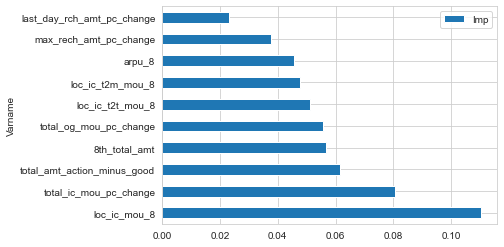

In [131]:
imp_features = imp_df.sort_values(by="Imp", ascending=False).set_index('Varname')
imp_features[:10].plot(kind = 'barh')

Random Forest after handling class imbalance is giving better F1-Score so taking this model for getting feature imporatance.

## Important Features:

**The most important predictor variables to predict churn**
1. Local incoming calls for 8th Month, decrease significantly for churners.
2. Total incoming minutes of usage change between good and action months, are significant to detect churners. 
3. Total amount of recharge changes significantly for churners in action month.
4. Total recharge amount in action phase changes significantly for churners
5. Total outgoing minutes of usage drop significantly for churners.

### Visualize the important variables for churners vs non-churners

<AxesSubplot:xlabel='churn', ylabel='loc_ic_mou_8'>

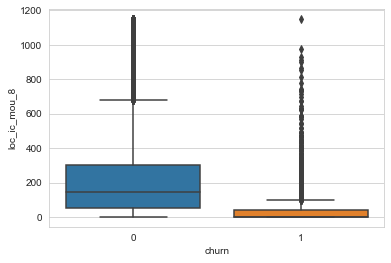

In [273]:
# local incoming minutes of usage in Action month 
sns.boxplot(x='churn', y='loc_ic_mou_8', data=telecom_hcv_copy)

<AxesSubplot:xlabel='churn', ylabel='total_ic_mou_pc_change'>

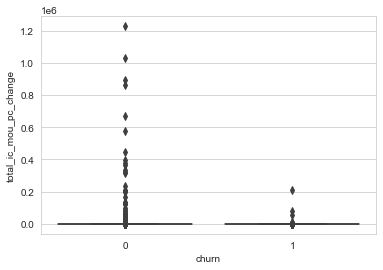

In [274]:
# total incoming MOU percentage change between good and action months
sns.boxplot(x='churn', y='total_ic_mou_pc_change', data=telecom_hcv_copy)

<AxesSubplot:xlabel='churn', ylabel='total_amt_action_minus_good'>

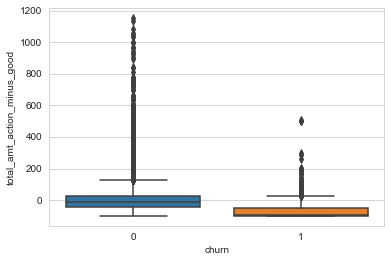

In [275]:
# percentage change in total recharge in good and action phase
sns.boxplot(x='churn', y='total_amt_action_minus_good', data=telecom_hcv_copy)

<AxesSubplot:xlabel='churn', ylabel='8th_total_amt'>

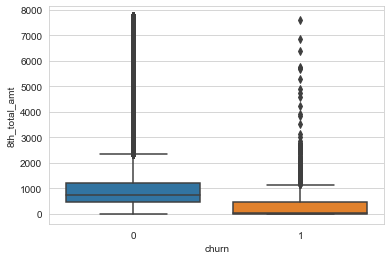

In [276]:
# Action month total recharge
sns.boxplot(x='churn', y='8th_total_amt', data=telecom_hcv_copy)

<AxesSubplot:xlabel='churn', ylabel='total_og_mou_pc_change'>

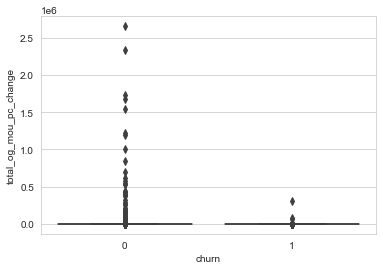

In [277]:
# percentage change in total outgoing MOU in Good and Action Phase 
sns.boxplot(x='churn', y='total_og_mou_pc_change', data=telecom_hcv_copy)

### As can be seen, there are very clear differences between churners and non-churners for the above attributes. As an action strategy, the telecom company should keep a close eye on these 5 attributes of customer behavior and have their customer care agents talk to these identified customers and offer them something of value like an attractive plan, some freebies etc. to keep them tied to the network